<a href="https://colab.research.google.com/github/kkumar47/Loan_Prediction/blob/master/Loan_Prediction_Component_Test_Case.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

***Component Testing***

*Test Case 1*

In [2]:
! pip install -q streamlit

     |████████████████████████████████| 9.2 MB 13.4 MB/s 
     |████████████████████████████████| 181 kB 44.7 MB/s 
     |████████████████████████████████| 78 kB 5.9 MB/s 
     |████████████████████████████████| 4.7 MB 62.3 MB/s 
     |████████████████████████████████| 235 kB 30.5 MB/s 
     |████████████████████████████████| 164 kB 60.7 MB/s 
     |████████████████████████████████| 63 kB 1.1 MB/s 
     |████████████████████████████████| 51 kB 5.3 MB/s 


In [3]:
import streamlit as st
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from numpy import mean
import plotly.express as px
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
import time
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.optimizers import SGD, Adam
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.metrics import roc_curve,auc, roc_auc_score


INFO:numexpr.utils:NumExpr defaulting to 2 threads.
2022-09-25 18:02:30.473 INFO    numexpr.utils: NumExpr defaulting to 2 threads.


*Test Case 2*

In [4]:
rawdf = pd.read_csv('https://raw.githubusercontent.com/kkumar47/Loan_Prediction/master/lending_club_loan_two.csv')

In [5]:
rawdf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396030 entries, 0 to 396029
Data columns (total 27 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   loan_amnt             396030 non-null  float64
 1   term                  396030 non-null  object 
 2   int_rate              396030 non-null  float64
 3   installment           396030 non-null  float64
 4   grade                 396030 non-null  object 
 5   sub_grade             396030 non-null  object 
 6   emp_title             373103 non-null  object 
 7   emp_length            377729 non-null  object 
 8   home_ownership        396030 non-null  object 
 9   annual_inc            396030 non-null  float64
 10  verification_status   396030 non-null  object 
 11  issue_d               396030 non-null  object 
 12  loan_status           396030 non-null  object 
 13  purpose               396030 non-null  object 
 14  title                 394275 non-null  object 
 15  

*Test Case 3*

In [6]:
px.histogram(rawdf, x="loan_status", color="loan_status")

[Text(0.5, 1.0, 'Loan Amount Distribution')]

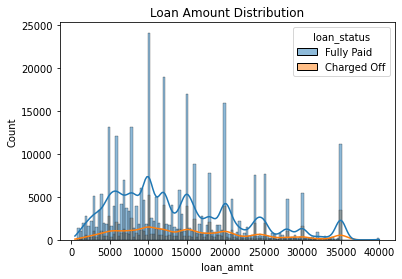

In [7]:
sns.histplot(x="loan_amnt", hue ='loan_status',data=rawdf, kde=True).set(title='Loan Amount Distribution')

In [8]:
px.scatter(rawdf, x="installment", y="loan_amnt", color="loan_status", color_discrete_sequence=px.colors.qualitative.Vivid)

In [9]:
px.box(rawdf, x="loan_status", y="loan_amnt", color="loan_status")

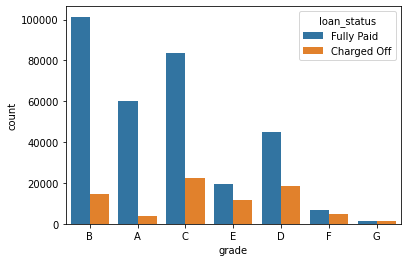

In [10]:
sns.countplot(x="grade", data=rawdf, hue="loan_status")

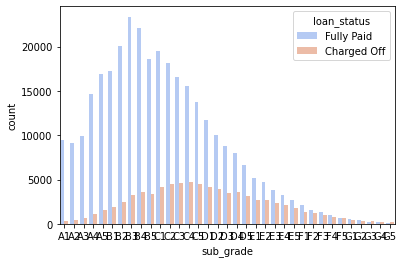

In [11]:
subgrade_order = sorted(rawdf["sub_grade"].unique())
sns.countplot(x="sub_grade", data=rawdf, palette="coolwarm", order=subgrade_order, hue="loan_status")

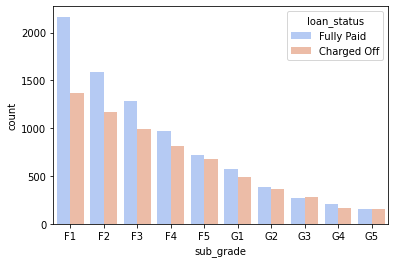

In [12]:
f_g = rawdf[(rawdf["grade"]=="F") | (rawdf["grade"]=="G")]
subgrade_order = sorted(f_g["sub_grade"].unique())
sns.countplot(x="sub_grade", data=f_g, palette="coolwarm", order=subgrade_order, hue="loan_status")

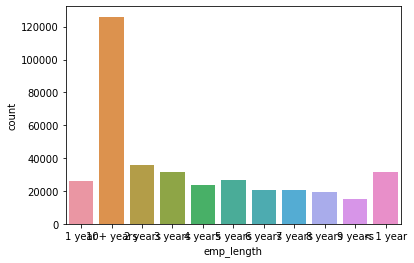

In [13]:
emp_length_order = sorted(rawdf["emp_length"].dropna().unique())
sns.countplot(x="emp_length",data=rawdf,order=emp_length_order)

*Test Case 4*

In [14]:
px.imshow(rawdf.corr(), text_auto=True)

*Test Case 5*

In [15]:
rawdf.isnull().sum()

loan_amnt                   0
term                        0
int_rate                    0
installment                 0
grade                       0
sub_grade                   0
emp_title               22927
emp_length              18301
home_ownership              0
annual_inc                  0
verification_status         0
issue_d                     0
loan_status                 0
purpose                     0
title                    1755
dti                         0
earliest_cr_line            0
open_acc                    0
pub_rec                     0
revol_bal                   0
revol_util                276
total_acc                   0
initial_list_status         0
application_type            0
mort_acc                37795
pub_rec_bankruptcies      535
address                     0
dtype: int64

In [16]:
# Drop Columns that are not strongly Correlated to output
rawdf = rawdf.drop("emp_title", axis=1)
rawdf = rawdf.drop("emp_length", axis=1)
rawdf = rawdf.drop("title", axis=1)

In [17]:
# Handle Null Values
total_acc_avg = rawdf.groupby("total_acc").mean()["mort_acc"]
def fill_mort_acc(total_acc,mort_acc):
			if np.isnan(mort_acc):
				return total_acc_avg[total_acc]
			else:
				return mort_acc
rawdf["mort_acc"] = rawdf.apply(lambda x: fill_mort_acc(x["total_acc"],x["mort_acc"]),axis=1)
rawdf = rawdf.dropna()

In [18]:
rawdf.isnull().sum()

loan_amnt               0
term                    0
int_rate                0
installment             0
grade                   0
sub_grade               0
home_ownership          0
annual_inc              0
verification_status     0
issue_d                 0
loan_status             0
purpose                 0
dti                     0
earliest_cr_line        0
open_acc                0
pub_rec                 0
revol_bal               0
revol_util              0
total_acc               0
initial_list_status     0
application_type        0
mort_acc                0
pub_rec_bankruptcies    0
address                 0
dtype: int64

*Test Case 6*

In [19]:
le = preprocessing.LabelEncoder()
le.fit(rawdf['loan_status'])
rawdf['loan_repaid']=le.transform(rawdf['loan_status'])
df = rawdf.drop_duplicates(['loan_repaid','loan_status'])[['loan_repaid','loan_status']]
df

,loan_repaid,loan_status
0,1,Fully Paid
4,0,Charged Off


*Test Case 7*

In [20]:
rawdf["term"] = rawdf["term"].apply(lambda term: 36 if term=='36 months' else 60)
rawdf = rawdf.drop("grade", axis=1)
dummies = pd.get_dummies(rawdf["sub_grade"],drop_first=True)
rawdf = pd.concat([rawdf.drop("sub_grade", axis=1),dummies],axis=1)
dummies = pd.get_dummies(rawdf[['verification_status', 'application_type','initial_list_status','purpose']],drop_first=True)
rawdf = pd.concat([rawdf.drop(['verification_status', 'application_type','initial_list_status','purpose'], axis=1),dummies],axis=1)
rawdf["home_ownership"] = rawdf["home_ownership"].replace(["NONE","ANY"],"OTHER")
dummies = pd.get_dummies(rawdf["home_ownership"],drop_first=True)
rawdf = pd.concat([rawdf.drop("home_ownership", axis=1),dummies],axis=1)
			
rawdf["zipcode"] = rawdf["address"].apply(lambda adress : adress[-5:])
dummies = pd.get_dummies(rawdf["zipcode"],drop_first=True)
rawdf = pd.concat([rawdf.drop("zipcode", axis=1),dummies],axis=1)
rawdf = rawdf.drop("address", axis=1)
rawdf = rawdf.drop("issue_d", axis=1)
			
rawdf["earliest_cr_line"] = rawdf["earliest_cr_line"].apply(lambda date: int(date[-4:]))

In [21]:
rawdf = rawdf.drop("loan_status", axis=1)
rawdf.head(10)

,loan_amnt,term,int_rate,installment,annual_inc,dti,earliest_cr_line,open_acc,pub_rec,revol_bal,...,RENT,05113,11650,22690,29597,30723,48052,70466,86630,93700
0,10000.0,60,11.44,329.48,117000.0,26.24,1990,16.0,0.0,36369.0,...,1,0,0,1,0,0,0,0,0,0
1,8000.0,60,11.99,265.68,65000.0,22.05,2004,17.0,0.0,20131.0,...,0,1,0,0,0,0,0,0,0,0
2,15600.0,60,10.49,506.97,43057.0,12.79,2007,13.0,0.0,11987.0,...,1,1,0,0,0,0,0,0,0,0
3,7200.0,60,6.49,220.65,54000.0,2.60,2006,6.0,0.0,5472.0,...,1,0,0,0,0,0,0,0,0,0
4,24375.0,60,17.27,609.33,55000.0,33.95,1999,13.0,0.0,24584.0,...,0,0,1,0,0,0,0,0,0,0
5,20000.0,60,13.33,677.07,86788.0,16.31,2005,8.0,0.0,25757.0,...,0,0,0,0,0,1,0,0,0,0
6,18000.0,60,5.32,542.07,125000.0,1.36,2005,8.0,0.0,4178.0,...,0,0,0,1,0,0,0,0,0,0
7,13000.0,60,11.14,426.47,46000.0,26.87,1994,11.0,0.0,13425.0,...,1,0,0,0,0,1,0,0,0,0
8,18900.0,60,10.99,410.84,103000.0,12.52,1994,13.0,0.0,18637.0,...,1,0,0,1,0,0,0,0,0,0
9,26300.0,60,16.29,928.40,115000.0,23.69,1997,13.0,0.0,22171.0,...,0,0,0,0,0,0,0,0,0,0


In [22]:
rawdf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 395219 entries, 0 to 396029
Data columns (total 79 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   loan_amnt                            395219 non-null  float64
 1   term                                 395219 non-null  int64  
 2   int_rate                             395219 non-null  float64
 3   installment                          395219 non-null  float64
 4   annual_inc                           395219 non-null  float64
 5   dti                                  395219 non-null  float64
 6   earliest_cr_line                     395219 non-null  int64  
 7   open_acc                             395219 non-null  float64
 8   pub_rec                              395219 non-null  float64
 9   revol_bal                            395219 non-null  float64
 10  revol_util                           395219 non-null  float64
 11  total_acc    

*Test Case 8*

In [23]:
W = rawdf.drop("loan_repaid", axis=1)
z = rawdf["loan_repaid"]
W_train, W_test, z_train, z_test = train_test_split(W,z,test_size=0.25, random_state=42)
rf = RandomForestRegressor(n_estimators=150)
rf.fit(W_train, z_train)
sort = rf.feature_importances_.argsort()
sort = pd.DataFrame(sort, columns=['Score'])

In [24]:
sort['Feature Name'] = pd.DataFrame(W.columns)
sort = sort.sort_values(by=['Score'])
px.bar(sort, x="Score", y="Feature Name", orientation='h')

*Test Case 9*

In [25]:
X = rawdf.drop("loan_repaid", axis=1).values
y = rawdf["loan_repaid"].values
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2, random_state=42)

In [26]:
X_train.shape

(316175, 78)

In [27]:
X_test.shape

(79044, 78)

In [28]:
#Standardize the Data
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [29]:
# Set the Optimizer (Hyperparameter) for the Model
opt=SGD(learning_rate=0.5)

In [30]:
# Define the CNN Model
model = Sequential()
model.add(Dense(78, activation="relu"))
model.add(Dropout(0.2)) #preventing overfitting

model.add(Dense(39, activation="relu")) #reducing number of neurons of a half
model.add(Dropout(0.2))

model.add(Dense(19, activation="relu"))
model.add(Dropout(0.2))

model.add(Dense(units=1, activation="sigmoid")) #because it's a binary classification

model.compile(loss="binary_crossentropy", optimizer=opt, metrics=['accuracy'])

In [31]:
# Fit the CNN Model
model.fit(x = X_train, y = y_train, epochs = 25, batch_size = 256, validation_data=(X_test, y_test))

Epoch 1/25
1236/1236 [==============================] - 6s 4ms/step - loss: 0.2908 - accuracy: 0.8810 - val_loss: 0.2637 - val_accuracy: 0.8889
Epoch 2/25
1236/1236 [==============================] - 4s 3ms/step - loss: 0.2662 - accuracy: 0.8874 - val_loss: 0.2743 - val_accuracy: 0.8889
Epoch 3/25
1236/1236 [==============================] - 4s 3ms/step - loss: 0.2647 - accuracy: 0.8876 - val_loss: 0.2621 - val_accuracy: 0.8889
Epoch 4/25
1236/1236 [==============================] - 4s 3ms/step - loss: 0.2640 - accuracy: 0.8875 - val_loss: 0.2666 - val_accuracy: 0.8890
Epoch 5/25
1236/1236 [==============================] - 4s 3ms/step - loss: 0.2635 - accuracy: 0.8876 - val_loss: 0.2750 - val_accuracy: 0.8890
Epoch 6/25
1236/1236 [==============================] - 4s 3ms/step - loss: 0.2633 - accuracy: 0.8876 - val_loss: 0.2620 - val_accuracy: 0.8889
Epoch 7/25
1236/1236 [==============================] - 4s 3ms/step - loss: 0.2628 - accuracy: 0.8879 - val_loss: 0.2632 - val_accuracy:

In [32]:
#Model Evaluation
losses = pd.DataFrame(model.history.history)

In [33]:
losses

,loss,accuracy,val_loss,val_accuracy
0,0.290801,0.881012,0.263692,0.888923
1,0.266229,0.887417,0.274277,0.888897
2,0.264747,0.887584,0.262061,0.888910
3,0.263976,0.887452,0.266598,0.888961
4,0.263452,0.887594,0.275042,0.889024
5,0.263305,0.887603,0.261953,0.888897
6,0.262796,0.887891,0.263162,0.888897
7,0.262443,0.887613,0.260707,0.888910
8,0.262287,0.887958,0.261820,0.888847
9,0.262044,0.887872,0.260971,0.888999


*Test Case 10*

In [34]:
# Predict using CNN
predictions = (model.predict(X_test) > 0.5).astype("int32")

In [35]:
result =confusion_matrix(y_test,predictions)
px.imshow(result, text_auto=True)

In [36]:
#ROC-AUC
fpr_keras, tpr_keras, thresholds_keras = roc_curve(y_test, predictions)
auc_keras = auc(fpr_keras, tpr_keras)
auc_keras

0.7154883415213065

In [37]:
#Mean Accuracy
sum(losses['val_accuracy'])/25

0.8884514904022217

*Test Case 11*

In [38]:
#Gradient Boost Model Training with Hyperparameter 
lrtx = 0.5 #Set Learning Rate
est = 500 # Set the number of Estimator
clf = GradientBoostingClassifier(n_estimators=est, learning_rate=lrtx,max_depth=1, random_state=0).fit(X_train, y_train)

In [39]:
# Mean Accuracy
clf.score(X_test, y_test)

0.8896310915439503

In [40]:
# ROC - AUC
probs_xg = clf.predict_proba(X_test)[:, 1]
auc_xg = roc_auc_score(y_test, probs_xg)
fpr_xg, tpr_xg, thresholds_xg = roc_curve(y_test, probs_xg)
auc_xg

0.904087385100109

In [41]:
y_pred_xg = clf.predict(X_test)
xg_matrix = metrics.confusion_matrix(y_test, y_pred_xg)
classification_report(y_test, y_pred_xg)

'              precision    recall  f1-score   support\n\n           0       0.96      0.45      0.61     15421\n           1       0.88      1.00      0.94     63623\n\n    accuracy                           0.89     79044\n   macro avg       0.92      0.72      0.78     79044\nweighted avg       0.90      0.89      0.87     79044\n'

In [42]:
px.imshow(xg_matrix, text_auto=True)

*Test Case 12*

In [43]:
# Logistic Regression
logreg = LogisticRegression(random_state=16)
logreg.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression(random_state=16)

In [44]:
y_pred = logreg.predict(X_test)
logreg_acc = logreg.score(X_train, y_train)
probs_xg = logreg.predict_proba(X_test)[:, 1]
auc_lr = roc_auc_score(y_test, probs_xg)
fpr_xg, tpr_xg, thresholds_xg = roc_curve(y_test, probs_xg)

In [45]:
# Mean Accuracy
logreg_acc

0.8881885032023404

In [46]:
# ROC-AUC
auc_lr

0.9018131325990271

In [47]:
classification_report(y_test, y_pred)

'              precision    recall  f1-score   support\n\n           0       0.98      0.44      0.61     15421\n           1       0.88      1.00      0.94     63623\n\n    accuracy                           0.89     79044\n   macro avg       0.93      0.72      0.77     79044\nweighted avg       0.90      0.89      0.87     79044\n'

In [48]:
lr_matrix = metrics.confusion_matrix(y_test, y_pred)
px.imshow(lr_matrix, text_auto=True)